# Segment Stanford videos Using the ***pre-trained*** CAMUS model
Stough, 7/20

Here I'm taking my CAMUS-trained UNet-like model and pushing Stanford ap4 data through. Unlike the
[play_camusSegmentsDynamic.ipynb](play_camusSegmentsDynamic.ipynb) this is based on, here I want to 
segment the video to find the peaks. I'll use all 10 folds though, to get a smoother estimate maybe.

In [1]:
%matplotlib inline 
import matplotlib
import matplotlib.pyplot as plt

import numpy as np
import copy
import SimpleITK as itk
import pandas as pd
import pickle
import copy

import os
import h5py

import cv2

# Being able to use the utility functions here.
import sys
module_path = os.path.abspath(os.path.join('camus'))
if module_path not in sys.path:
    sys.path.insert(0, module_path)
    
sys.path.insert(0, 'camus/utils/')


from camus.utils.camus_config import CAMUS_CONFIG
from camus.utils.echo_utils import makeVideo
from camus.utils.camus_load_info import (make_camus_echo_dataset,
                                       split_camus_echo,
                                       make_camus_EHR,
                                       CAMUS_TRAINING_DIR,
                                       CAMUS_TESTING_DIR,
                                       CAMUS_RESULTS_DIR)
from camus.utils.camus_transforms import (LoadSITKFromFilename,
                                        SitkToNumpy,
                                        ResizeTransform,
                                        ResizeImagesAndLabels,
                                        WindowImagesAndLabels,
                                        RotateImagesAndLabels,
                                        random_Rotater,
                                        random_GaussNoiser,
                                        random_Windower,
                                        identity_Transform,
                                        GaussianNoiseEcho)
from camus.utils.camus_validate import (camus_overlay,
                                      labColorMap,
                                      labColor_cmap,
                                      labNameMap,
                                      nameLabMap,
                                      dict_extend_values,
                                      camus_dice_by_name,
                                      cleanupBinary,
                                      cleanupSegmentation)
from camus.utils.torch_utils import (TransformDataset,
                                   torch_collate,
                                   run_training,
                                   run_validation,
                                   run_validation_returnAll,
                                   BetterLoss)
from camus.torch_models import UNetLike
from camus.segment_common import segment_echo

from camus.utils.echo_utils import (transformResizeImage,
                                    readTransformResizeImage)

import random
from random import shuffle
from scipy.special import softmax

from skimage.transform import (rescale, 
                               resize, 
                               rotate)


# torch
import torch
import torchvision
import torch.optim as optim
import torch.backends.cudnn as cudnn

from torch import nn
from torch.autograd import Variable
from torch.nn import Module

from torch.utils.data import (DataLoader, Dataset)
from torchvision.transforms import Compose
from torch.nn.functional import interpolate

# For timing.
import time
tic, toc = (time.time, time.time)

import echonet
from argparse import Namespace

In [2]:
args = Namespace(image_size=[256, 256],
                 batch_size=10, 
                 max_length=200,
                 length=200,
                 period=1)

&nbsp;

## Set up the model
We'll define how to load the model.

In [3]:
VIEWS=['2CH', '4CH']
PHASE_MAP = {'ED':0, 'ES':1}

lvIndex = nameLabMap['Left Ventricle']

# Constant over all CAMUS images
# Remember this is width x height though, so xy instead of the ij
# I use in my math. So the proper scaling to send to computVolume is
# (PIX_Y, PIX_X)
PIX_X = .308
PIX_Y = .154

In [4]:
pathconfig = CAMUS_CONFIG['paths']

# Load the dataset and ehr
# camusByPat = make_camus_echo_dataset(pathconfig['CAMUS_TRAINING_DIR'], args.view)
camusByPat = dict([(key, make_camus_echo_dataset(CAMUS_TESTING_DIR, key)) for key in VIEWS])


# Load the fold info. Here, really I only need the number of folds.
foldfilename = os.path.join(CAMUS_RESULTS_DIR, pathconfig['folds_file'])
with open(foldfilename, 'rb') as fid:
    kf = pickle.load(fid)

NUMFOLDS = len(kf)


augconfig = CAMUS_CONFIG['augment']
# The saved model name that generated the results. 
modelpathname = {}
for view in VIEWS:
    model_fname = 'aug_{}_fold_{{}}_win_{}_{}_rot_{}_noise_{}_{}.pth'.format(
        view,
        augconfig['windowing_scale'][0], augconfig['windowing_scale'][1],
        augconfig['rotation_scale'],
        augconfig['noise_scale'][0], augconfig['noise_scale'][1])

    modelpathname[view] = os.path.join(CAMUS_RESULTS_DIR, 
                                       'saved_models',
                                       model_fname)

print('Defined modelpathname {},\n'
      '                      {},\n'
      'camusByPat, and NUMFOLDS {}.'.format(modelpathname['2CH'], 
                                            modelpathname['4CH'],
                                            NUMFOLDS))

Defined modelpathname /home/stough/data/CAMUS/results/saved_models/aug_2CH_fold_{}_win_0.5_1.0_rot_5.0_noise_0.0_0.15.pth,
                      /home/stough/data/CAMUS/results/saved_models/aug_4CH_fold_{}_win_0.5_1.0_rot_5.0_noise_0.0_0.15.pth,
camusByPat, and NUMFOLDS 10.


In [5]:
def load_UNet(pathname):
    global CAMUS_CONFIG
    
    # First, clear previous gpu stuff.
    torch.cuda.empty_cache()

    net_seg = UNetLike(**CAMUS_CONFIG['unet'])
    net_seg = torch.nn.DataParallel(net_seg)
    net_seg.cuda(); # semicolon suppresses summary printout of the model. Seems unecessary with the dataparallel

    net_seg.load_state_dict(torch.load(pathname))
    net_seg.eval();
    
    print('\tLoaded {}, with {} weights'.format(pathname,
                                                sum(p.numel() for p in net_seg.parameters() if p.requires_grad)))
    
    return net_seg

&nbsp;

## Look at the Stanford echo data

This section also includes practice on normalizing the video batches for the camusizer (see [next section](#CamusizeVideo)).

In [6]:
mean, std = echonet.utils.get_mean_and_std(echonet.datasets.Echo(split="train"))
tasks = ["EF", "EDV", "ESV"]
kwargs = {"target_type": tasks,
          "mean": mean,
          "std": std,
          "length": args.length,
          "period": args.period,
          "max_length": args.max_length
          }

100%|██████████| 16/16 [00:01<00:00, 14.40it/s]


In [7]:
# Set up datasets and dataloaders
test_dataset = echonet.datasets.Echo(split="test", **kwargs)
test_dataloader = torch.utils.data.DataLoader(test_dataset, 
                                               batch_size=args.batch_size, 
                                               num_workers=4, 
                                               shuffle=False, 
                                               pin_memory=False, 
                                               drop_last=True)

In [8]:
for (videos, outcomes) in test_dataloader:
    break

In [9]:
videos.shape

torch.Size([10, 3, 200, 112, 112])

In [10]:
print(videos.sum(1).shape)
videos = videos.sum(1)

torch.Size([10, 200, 112, 112])


In [11]:
AA = videos.clone()
AA = AA.view(videos.size(0), 200, -1)
AA -= AA.min(2, keepdim=True)[0]
AA /= AA.max(2, keepdim=True)[0]
AA = AA.view(videos.shape)

In [12]:
v = AA[5]
[v[i].max() for i in range(len(v))]

[tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),

In [13]:
torch.stack(outcomes, axis=1).shape

torch.Size([10, 3])

In [14]:
torch.tensor([]).reshape((0,3)).shape

torch.Size([0, 3])

In [15]:
totoutcomes = torch.tensor([])
totoutcomes = torch.cat((totoutcomes, torch.stack(outcomes, axis=1)))

In [16]:
torch.cat((totoutcomes, torch.stack(outcomes, axis=1)))

tensor([[ 55.9518, 107.7316,  47.4538],
        [ 41.0144, 121.0112,  71.3791],
        [ 50.7947,  68.9909,  33.9472],
        [ 50.6350,  68.2336,  33.6835],
        [ 63.0981, 128.3857,  47.3768],
        [ 58.4944,  74.6820,  30.9972],
        [ 67.3816,  53.7012,  17.5165],
        [ 57.2849,  46.8396,  20.0076],
        [ 59.9186, 156.1365,  62.5817],
        [ 61.0268,  83.3576,  32.4871],
        [ 55.9518, 107.7316,  47.4538],
        [ 41.0144, 121.0112,  71.3791],
        [ 50.7947,  68.9909,  33.9472],
        [ 50.6350,  68.2336,  33.6835],
        [ 63.0981, 128.3857,  47.3768],
        [ 58.4944,  74.6820,  30.9972],
        [ 67.3816,  53.7012,  17.5165],
        [ 57.2849,  46.8396,  20.0076],
        [ 59.9186, 156.1365,  62.5817],
        [ 61.0268,  83.3576,  32.4871]])

In [17]:
videos.shape

torch.Size([10, 200, 112, 112])

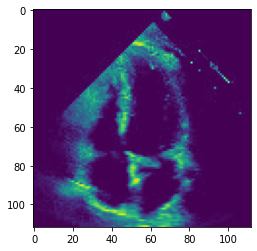

In [18]:
# Just to prove that a frame can be reconstructed from the view.
plt.imshow(AA[0,0].reshape(112,112))

In [19]:
[x.shape for x in outcomes]

[torch.Size([10]), torch.Size([10]), torch.Size([10])]

In [20]:
torch.stack(outcomes, axis=1)

tensor([[ 55.9518, 107.7316,  47.4538],
        [ 41.0144, 121.0112,  71.3791],
        [ 50.7947,  68.9909,  33.9472],
        [ 50.6350,  68.2336,  33.6835],
        [ 63.0981, 128.3857,  47.3768],
        [ 58.4944,  74.6820,  30.9972],
        [ 67.3816,  53.7012,  17.5165],
        [ 57.2849,  46.8396,  20.0076],
        [ 59.9186, 156.1365,  62.5817],
        [ 61.0268,  83.3576,  32.4871]])

In [21]:
AA.shape

torch.Size([10, 200, 112, 112])

In [22]:
%%capture
vid = echonet.utils.makeVideo(AA[5], cmap='gray')

In [23]:
vid

&nbsp;

<a name="CamusizeVideo"></a>

## Using a callable object and [map](https://github.com/pytorch/pytorch/issues/437#issuecomment-272192380) on the dataloader 
to modify the data batches to fit into the CAMUS model (with [interpolate](https://discuss.pytorch.org/t/resize-tensor-without-converting-to-pil-image/52401)).

The CAMUS model expects:
- (batches x)1x256x256 single-channel
- intensities in [0,1]

The batches that come out of the Stanford dataloader are `[10, 3, 200, 112, 112]` (batch, channels, frames, height, width). 
So we need to gray and normalize every frame, and somehow return batch x frames x 1 x 256 x 256


In [24]:
class CamusizeVideo(object):
    def __init__(self, im_size=[256,256], max_length=args.max_length, norm=True):
        self.im_size = im_size
        self.max_length = max_length
        self.norm = norm
        
    def _norm(self, videos):
        # expecting b x f x h x w 
        # make 0-1, but in tensors:
        # https://discuss.pytorch.org/t/how-to-efficiently-normalize-a-batch-of-tensor-to-0-1/65122/4
        # print(f'_norm sees videos shape {videos.shape}\n')
        AA = videos.clone()
        AA = AA.view(videos.size(0), self.max_length, -1) # each frame is vectorized (256x256 -> 65536)
        AA -= AA.min(2, keepdim=True)[0] # subtract frame min from each frame
        AA /= AA.max(2, keepdim=True)[0] # divide by frame max for each frame
        AA = AA.view(videos.shape) # reconstitute the frames (65536 -> 256x256)
        return AA
    
    def _rgb2gray(self, videos):
        # Takes the 5D batch/c/f/h/w and collapses c to size 1 by combining the r,g,b components.
        # 0.2989 * R + 0.5870 * G + 0.1140 * B 
        return torch.mul(videos, torch.tensor([.2989, .5870, .1140])[None, :, None, None, None]).sum(1, keepdim=True)
        
    '''
    Object call: Should take video batches and convert to
    CAMUS-acceptable images (in [0-1], and 256x256 single channel):
    videos is b x c(3) x f x h x w. 
    '''
    def __call__(self, videos):
        out_videos = self._rgb2gray(videos) # -> b x 1 x f x h x w
        out_videos = interpolate(out_videos.squeeze(), size=self.im_size, 
                                 mode='bilinear', align_corners=False) # b x f x im_size
        
        out_videos = self._norm(out_videos) # -> norm each frame to [0,1]
        
        return out_videos.unsqueeze(2) # -> b x f x 1 x im_size

In [25]:
camusizer = CamusizeVideo(im_size=args.image_size, max_length=args.max_length, norm=True)

for (videos, outcomes) in test_dataloader:
    outcomes = torch.stack(outcomes, axis=1)
    
    camusized_videos = camusizer(videos)
    break

In [26]:
outcomes.shape

torch.Size([10, 3])

In [27]:
camusized_videos.shape

torch.Size([10, 200, 1, 256, 256])

In [28]:
%%capture
# vid = echonet.utils.makeVideo(np.transpose(camusized_frames, (0,2,3,1)))
vid = echonet.utils.makeVideo(camusized_videos.squeeze()[5], cmap='gray')

In [29]:
vid

In [30]:
v = camusized_videos.squeeze()[5]

In [31]:
[v[i].max() for i in range(len(v))]

[tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),
 tensor(1.),

In [32]:
camusized_videos.shape

torch.Size([10, 200, 1, 256, 256])

In [33]:
video = camusized_videos[5]

In [34]:
# finding the first nan frame, to avoid sending that through the network.
torch.isnan(video.view(200, -1)).any(1).nonzero().flatten()[0]

tensor(175)

In [35]:
videos.device

device(type='cpu')

&nbsp;

## Apply the CAMUS-trained model on this Stanford data

We want to segment all data for all 10 fold models. The line to load a model is
```
net_seg = load_UNet(modelpathname['4CH'].format(foldnum))
```

We also need a function to accumulate the video batch results.

In [36]:
def segment_videos(net_seg, videos, tooBig=200):
    # Loop over the frames of each of the videos.
    # The incoming video is b x f x 1 x h x w
    # Should return b x f x 4 x h x w - one channel for each object.
    # But the input to the model is N x C x h x w (C just happens to be 1 here). 
    # We'll have to add that channels dimension to the N x h x w video.
    
    assert len(videos.shape) == 5, 'segment_videos: echo must be b x f x 1 x 256 x 256, got shape {}'.format(videos.shape)
    b, f, c, h, w = videos.shape
    
    net_seg.eval()
    
    # Initialize torch tensor of answers.
    outputsSoFar = torch.tensor([])
    
    
    for video in videos:
        # Each video is f x 1 x h x w
        # Find the actual length of this video, by searching for the first frame with nan.
        try:
            # Have to cast to int here, because otherwise it's a Tensor and that 
            # may lead to integer division below.
            valid_frames = int(torch.isnan(video.view(f, -1)).any(1).nonzero().flatten()[0])
        except:
            valid_frames = f
          
        video = video[:valid_frames] # Get just the valid frames.
        # print(f'valid video is {video.shape}, valid_frames is {valid_frames}')
        
        
        # Hack !! If the echo has too many frames, it may exhaust memory on the GPU.
        if (valid_frames > tooBig): 
            print('segment_videos: splitting video with shape {}'.format(video.shape))
        
        nparts = int(np.ceil(valid_frames/tooBig))
        # print(f'nparts is {nparts}, ceil({valid_frames}/{tooBig}) -> {np.ceil(valid_frames/tooBig)}, valid_frames type {type(valid_frames)}')

        echoScoresSoFar = torch.tensor([])

        for i in range(nparts):
            # Pick up the frames to segment...
            echopart = video[i * tooBig:np.min([(i+1) * tooBig, valid_frames])]

            with torch.no_grad():

                if torch.cuda.is_available:
                    inputs = echopart.cuda()

                # wrap them in Variable
                inputs = Variable(inputs)

                # forward , just forward here.
                outputs_seg = net_seg(inputs)
            
            # Now cat this part with previous parts
            echoScoresSoFar = torch.cat((echoScoresSoFar,
                                         outputs_seg.detach().cpu()), 0)
            
        # If echoScoresSoFar isn't the right length, cat zeros for the difference.
        if valid_frames < f:
#             print(f'outputsSoFar shape {outputsSoFar.shape}, echoScoresSoFar shape {echoScoresSoFar.shape}. '
#                   f'valid_frames {valid_frames} echopart {echopart.shape}')
            ef, ec, eh, ew = echoScoresSoFar.shape
            echoScoresSoFar = torch.cat((echoScoresSoFar,
                                         torch.zeros(f-ef, ec, eh, ew)), 0)
            
        # Make sure echoScoresSoFar is the right size.
#         if len(outputsSoFar) == 0:
#             outputsSoFar = echoScoresSoFar.clone()[None,...]
#         else:
        outputsSoFar = torch.cat((outputsSoFar, 
                                  echoScoresSoFar[None,...]), 0)

    return outputsSoFar

In [37]:
camusized_videos.shape

torch.Size([10, 200, 1, 256, 256])

In [38]:
net_seg = load_UNet(modelpathname['4CH'].format(1))

	Loaded /home/stough/data/CAMUS/results/saved_models/aug_4CH_fold_1_win_0.5_1.0_rot_5.0_noise_0.0_0.15.pth, with 13068100 weights


In [39]:
batchoutputs = segment_videos(net_seg, camusized_videos)

In [40]:
batchoutputs.shape

torch.Size([10, 200, 4, 256, 256])

In [41]:
video = batchoutputs[0]

In [42]:
video.shape

torch.Size([200, 4, 256, 256])

In [43]:
video.sum((1,2,3)).isclose(torch.tensor(0.0)).nonzero().flatten()

tensor([], dtype=torch.int64)

In [44]:
torch.argmax(torch.nn.functional.softmax(video, dim=1), dim = 1).shape

torch.Size([200, 256, 256])

In [45]:
# Ripped from previous segment_Geisinger code for videos.
# The input is expected to be f x c(4) x h x w
# output is f x h x w
def argmax_softmax(video):
    f, c, h, w = video.shape
    try:
        valid = video.sum((1,2,3)).isclose(torch.tensor(0.0)).nonzero().flatten()[0]
    except:
        valid = f
    
    return torch.argmax(torch.nn.functional.softmax(video[:valid], dim=1), dim = 1)

In [59]:
%%capture
vid = echonet.utils.makeVideo(argmax_softmax(batchoutputs[5]), cmap=labColor_cmap)

In [60]:
vid

&nbsp;

# 

In [61]:
lvpix = argmax_softmax(batchoutputs[5])
y = lvpix.view(lvpix.size(0),-1).isclose(torch.tensor(0)).sum(1)

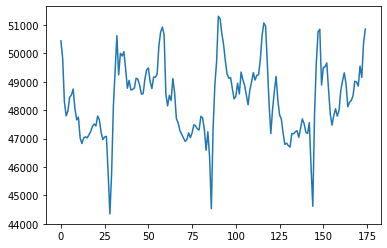

In [62]:
plt.plot(y)

In [54]:
lvpix.shape

torch.Size([200, 256, 256])

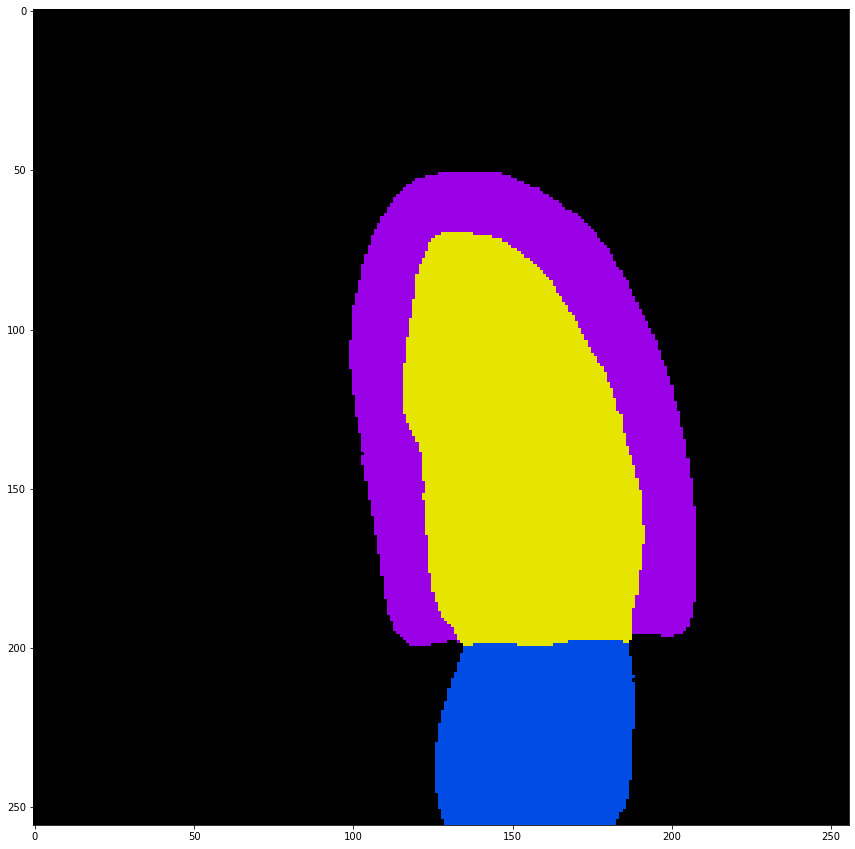

In [58]:
f, ax = plt.subplots(1,1, figsize=(15,15))
ax.imshow(lvpix[100], cmap = labColor_cmap, interpolation=None)